In [1]:
%config InlineBackend.figure_format = 'retina'
%matplotlib inline

import matplotlib.pyplot as plt
from matplotlib.colors import to_rgb, hex2color
import matplotlib.patheffects as PathEffects
from matplotlib.collections import LineCollection

import sys
import os

import numpy as np
from numpy_groupies.aggregate_numpy import aggregate
import cytograph as cg
import cytograph.visualization as cgplot

import shoji
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder
from scipy.cluster.hierarchy import dendrogram, cut_tree

from scipy.spatial.distance import pdist
from sklearn.preprocessing import scale
import fastcluster
import scipy.cluster.hierarchy as hc

from umap import UMAP

db = shoji.connect()

In [373]:
ws = db.builds.sten.humandev20220523.ClassGlioblastOligo

In [374]:
#umap = UMAP(n_neighbors=50, min_dist=0.5, init=ws.Embedding[:]).fit_transform(ws.Factors[:])
umap = ws.UMAP[:]

(-8.956132245063781, 21.09494478702545, -6.346256995201111, 19.770587229728697)

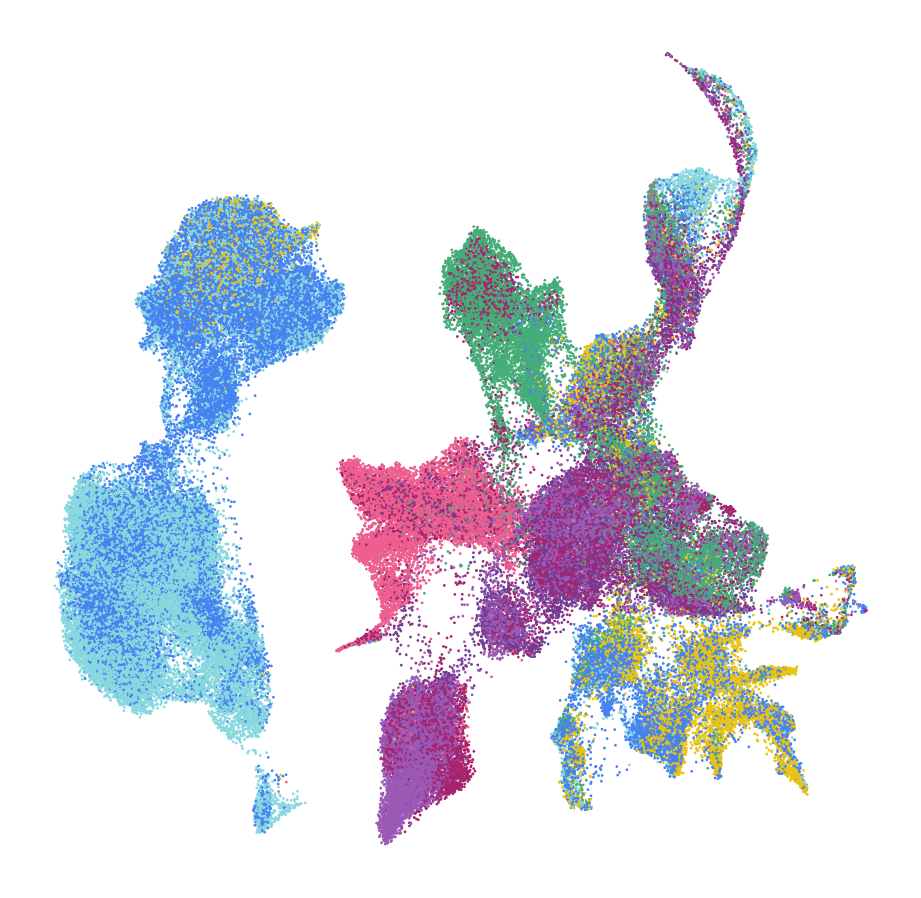

In [31]:
plt.figure(figsize=(8,8))
cgplot.scatterc(umap, c=ws.Region[:], colors="regions", legend=None)
plt.axis("off")

(-8.956132245063781, 21.09494478702545, -6.346256995201111, 19.770587229728697)

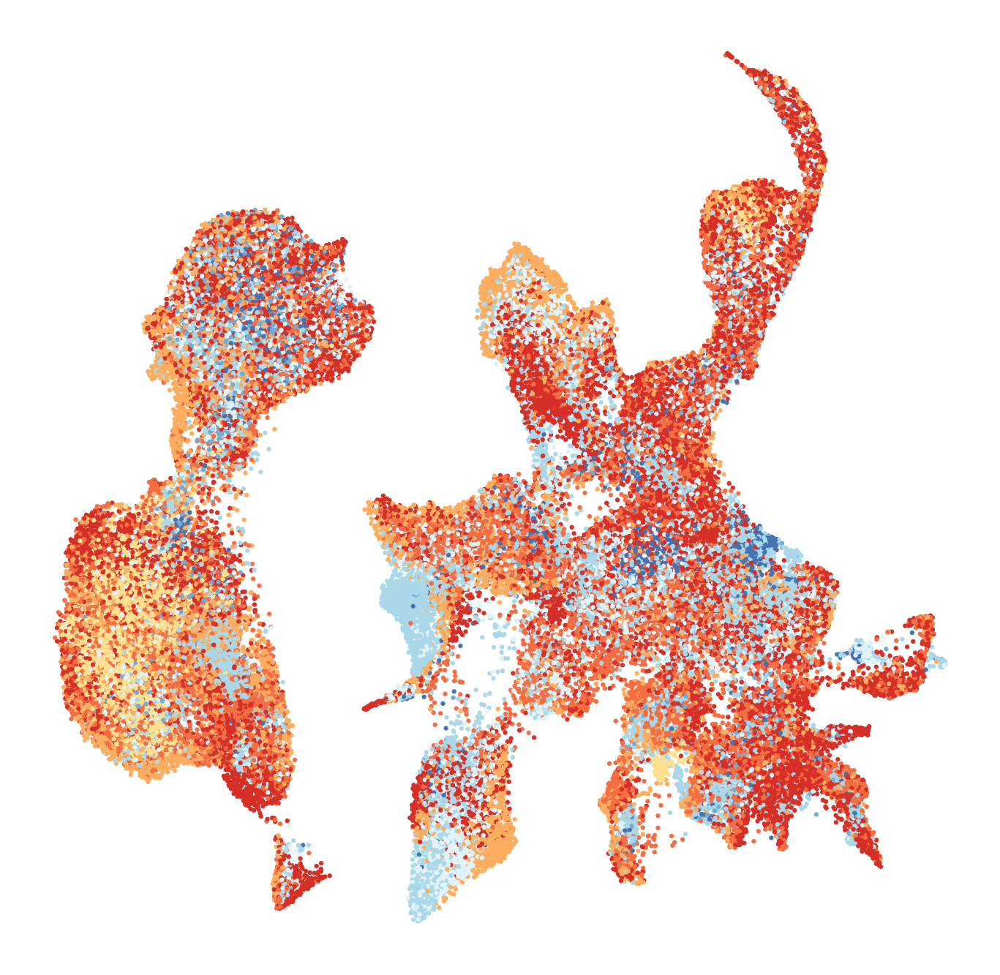

In [428]:
plt.figure(figsize=(12, 12))
cgplot.scattern(umap, c=ws.Age[:], vmin=5, vmax=14, cmap="age", s=10)
plt.axis("off")

(-8.956132245063781, 21.09494478702545, -6.346256995201111, 19.770587229728697)

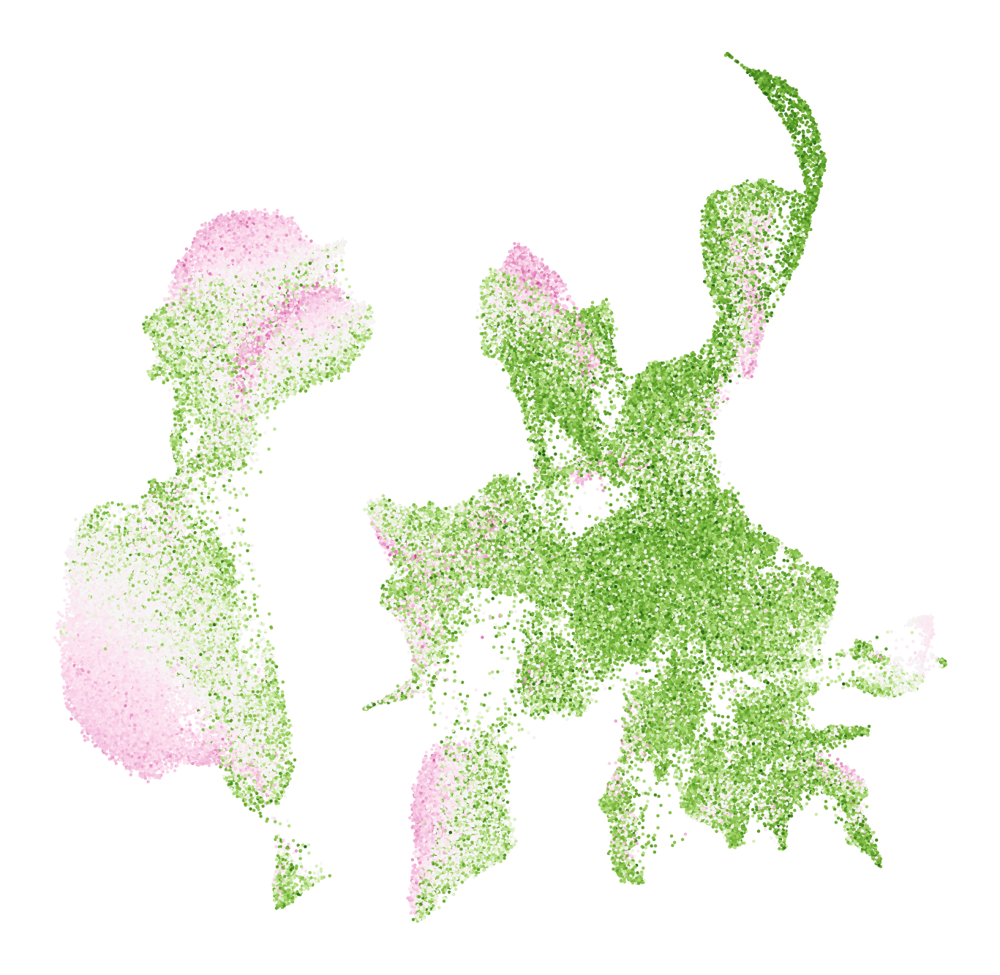

In [487]:
# Cell cycle
plt.figure(figsize=(12, 12))
cgplot.scattern(umap, c=ws.CellCycleFraction[:], norm=mpl.colors.TwoSlopeNorm(vcenter=0.004), cmap="PiYG_r", s=5)
plt.axis("off")
#plt.colorbar()

(-8.956132245063781, 21.09494478702545, -6.346256995201111, 19.770587229728697)

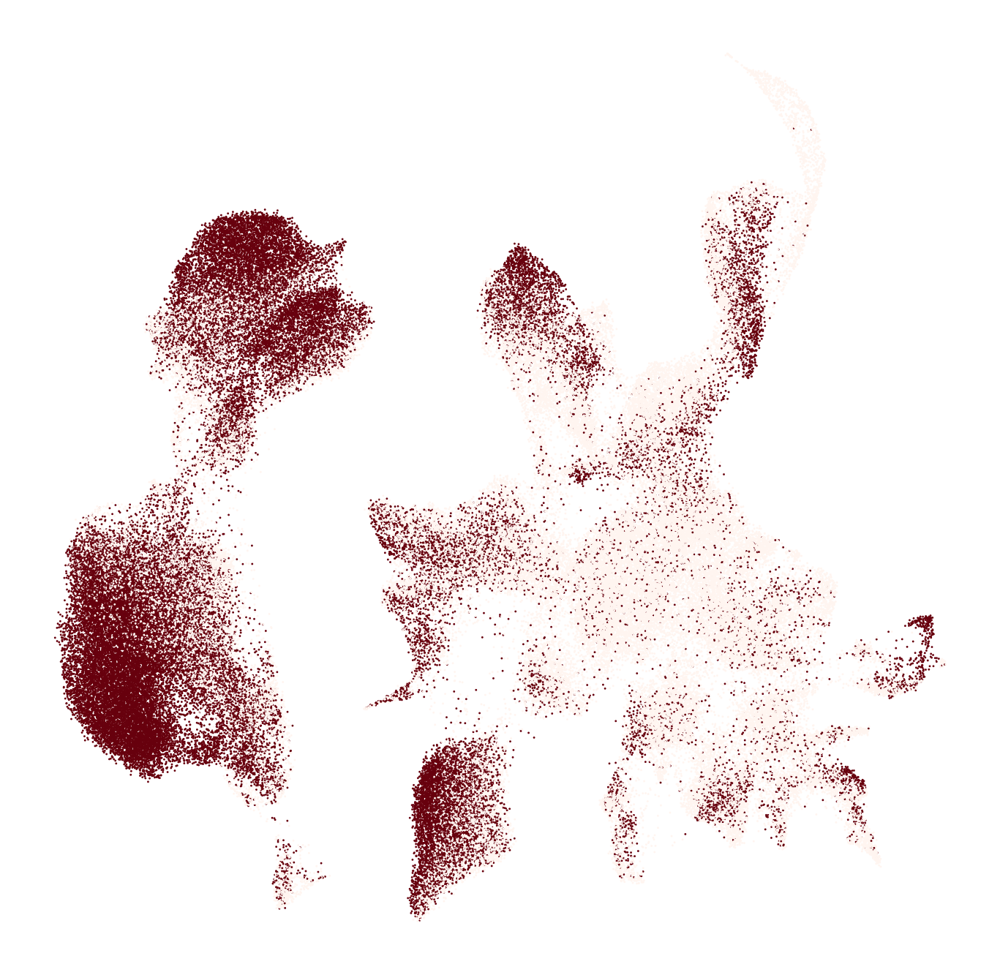

In [495]:
# Cell cycle
plt.figure(figsize=(12, 12))
cgplot.scattern(umap, c=ws.CellCycleFraction[:] > 0.004, vmax=0.004, cmap="Reds", s=2)
plt.axis("off")
#plt.colorbar()

(-8.956132245063781, 21.09494478702545, -6.346256995201111, 19.770587229728697)

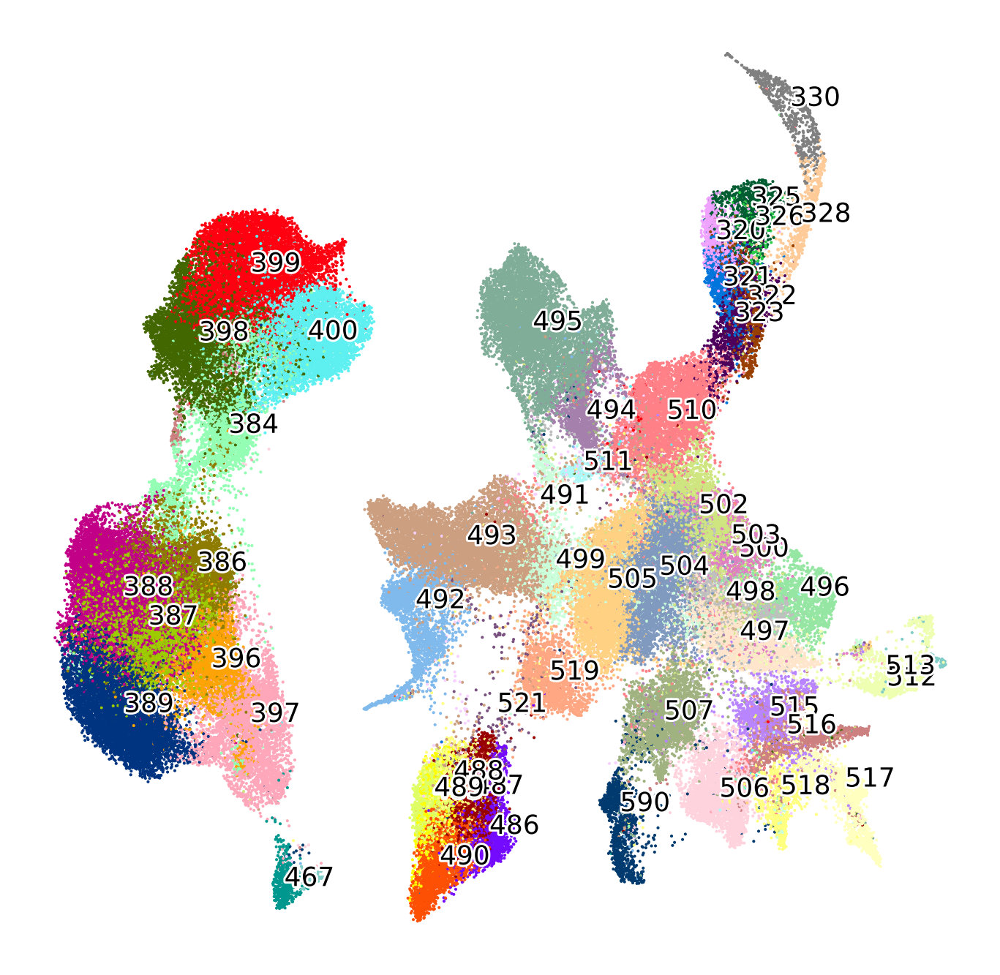

In [448]:
labels = []
n_cells = ws.NCells[:]
prev_clusters = ws.PrevClusters[:]
clusters = ws.Clusters[:]
n_clusters = clusters.max() + 1
cluster_ids = ws.ClusterID[:]
genes = ws.Gene[:]
enrichment = ws.Enrichment[:]
xy = umap
pc = aggregate(clusters, prev_clusters, func="first")
for i in range(ws.clusters.length):
    label = f"{pc[i]:>3} ({n:,} cells) "
    label += " ".join(genes[np.argsort(-enrichment[cluster_ids == clusters[i], :][0])[:10]])
    labels.append(label)

plt.figure(figsize=(12, 12))
ax = plt.subplot(111)


for i in np.unique(prev_clusters):
    pos = np.median(xy[prev_clusters == i], axis=0)
    txt = plt.text(pos[0], pos[1], str(i), size=18, color="black")
    txt.set_path_effects([PathEffects.withStroke(linewidth=3, foreground='w')])

cgplot.scatterc(xy, c=np.array(labels)[clusters], legend=None)
plt.axis("off")




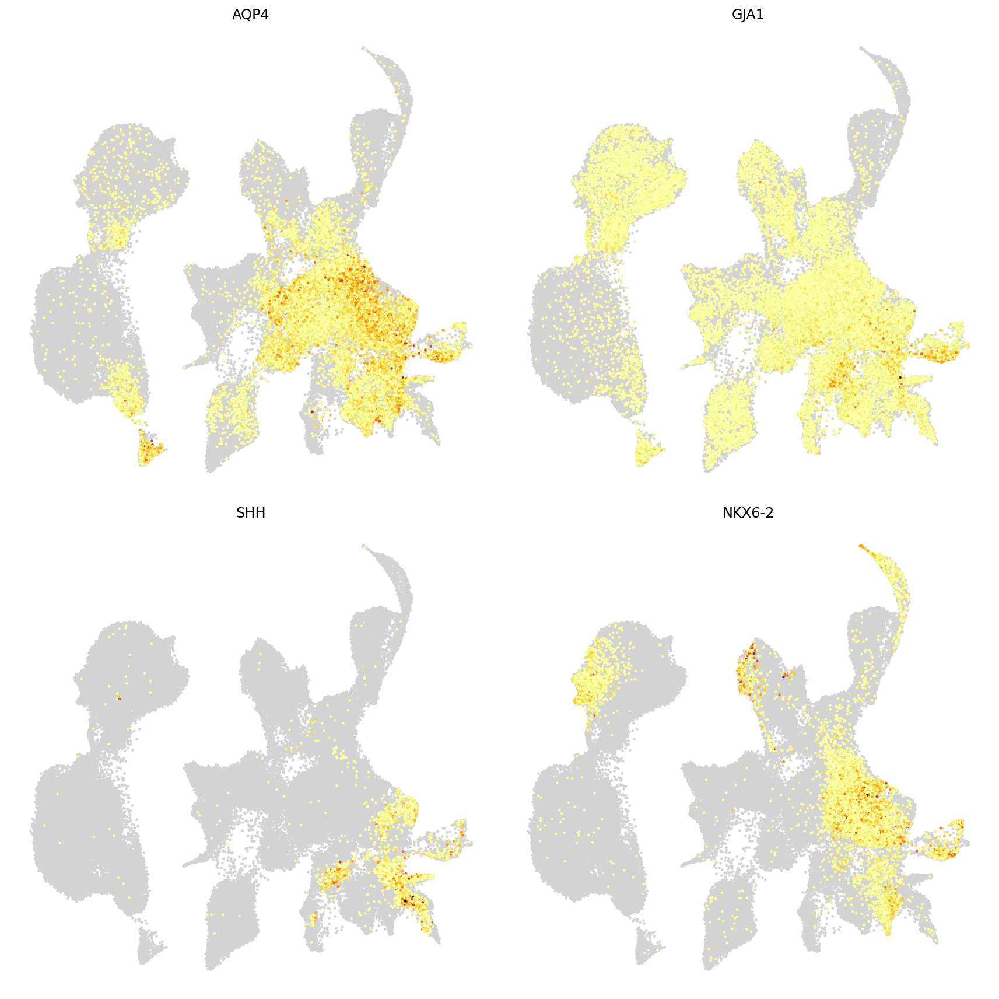

In [509]:
# Glioblast markers
plt.figure(figsize=(12,12))
genes = ["AQP4", "GJA1", "SHH", "NKX6-2"]
for i, gene in enumerate(genes):
    plt.subplot(2,2,i+1)
    cgplot.scattern(umap, c=ws.Expression[:, ws.Gene==gene].flatten(), bgval=0, s=5)
    plt.title(gene)
    plt.axis("off")
    plt.tight_layout()

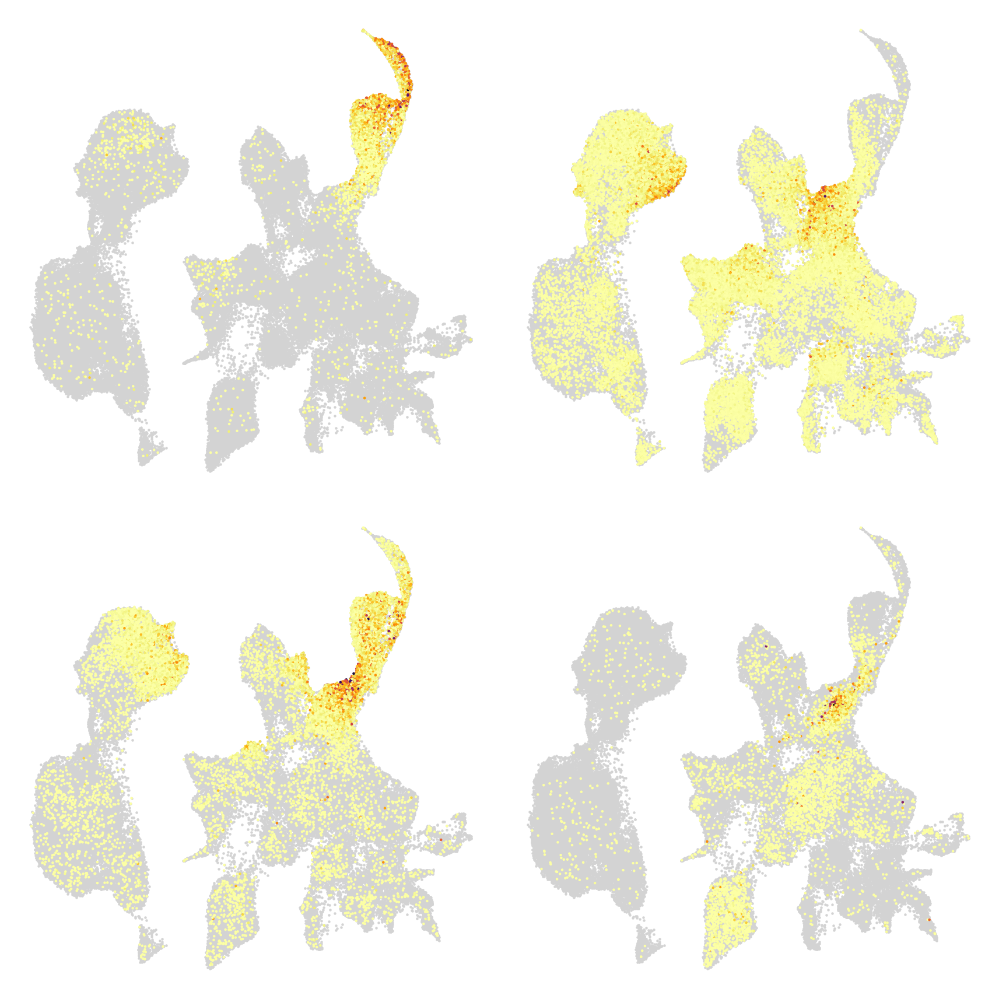

In [457]:
# Oligo lineage markers
plt.figure(figsize=(12,12))
genes = ["SOX10", "EGFR", "DLL3","CRABP1"]
for i, gene in enumerate(genes):
    plt.subplot(2,2,i+1)
    cgplot.scattern(umap, c=ws.Expression[:, ws.Gene==gene].flatten(), bgval=0, s=5)
    #plt.title(gene)
    plt.axis("off")
    plt.tight_layout()

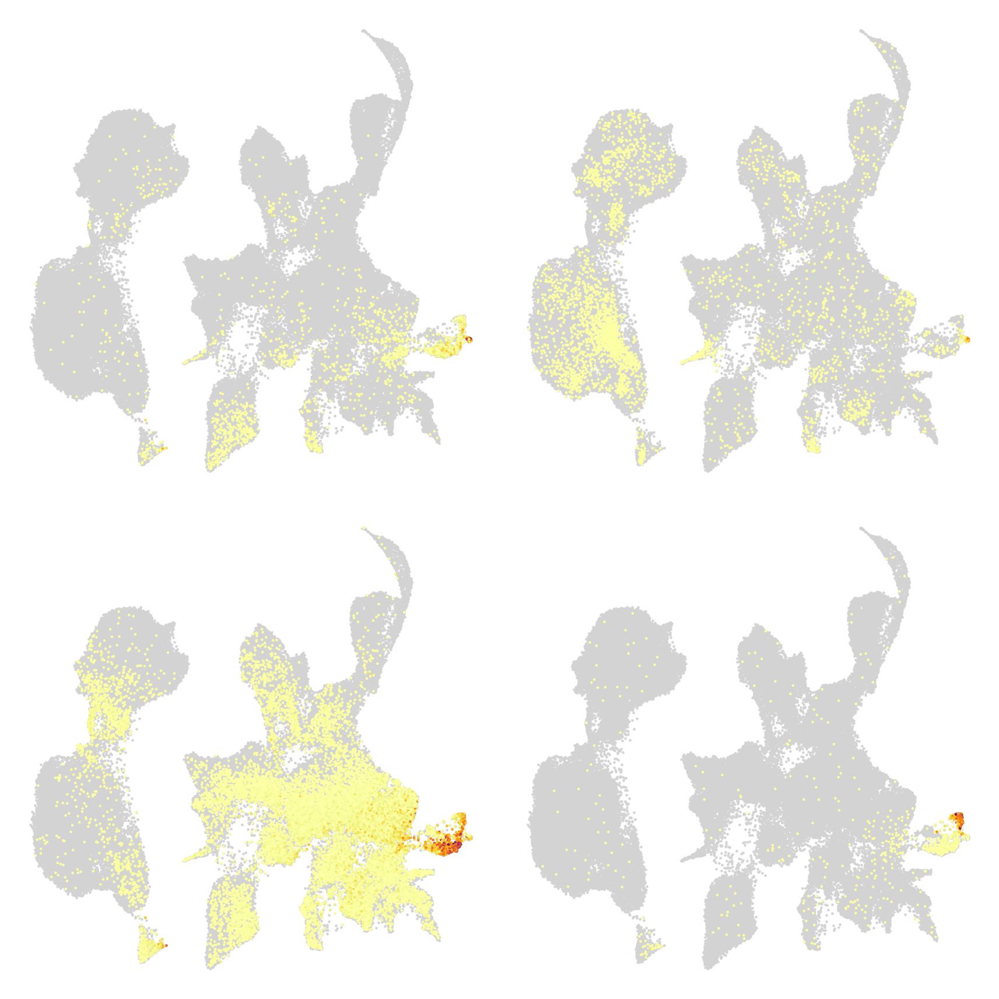

In [459]:
# Ependymal and choroid
plt.figure(figsize=(12,12))
genes = ["FOLR1", "TTR", "PIFO","CCNO"]
for i, gene in enumerate(genes):
    plt.subplot(2,2,i+1)
    cgplot.scattern(umap, c=ws.Expression[:, ws.Gene==gene].flatten(), bgval=0, s=5)
    #plt.title(gene)
    plt.axis("off")
    plt.tight_layout()

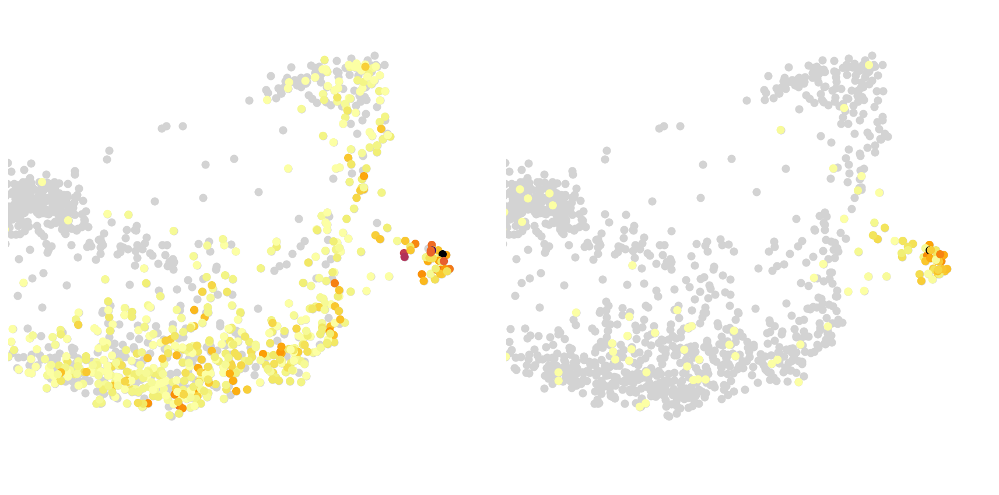

In [467]:
# Choroid (zoom in)
plt.figure(figsize=(12, 6))
genes = ["FOLR1", "TTR"]
for i, gene in enumerate(genes):
    plt.subplot(1, 2, i+1)
    cgplot.scattern(umap, c=ws.Expression[:, ws.Gene==gene].flatten(), bgval=0, s=50)
    plt.xlim(17,20)
    plt.ylim(0.5,3.5)
    plt.axis("off")
    plt.tight_layout()

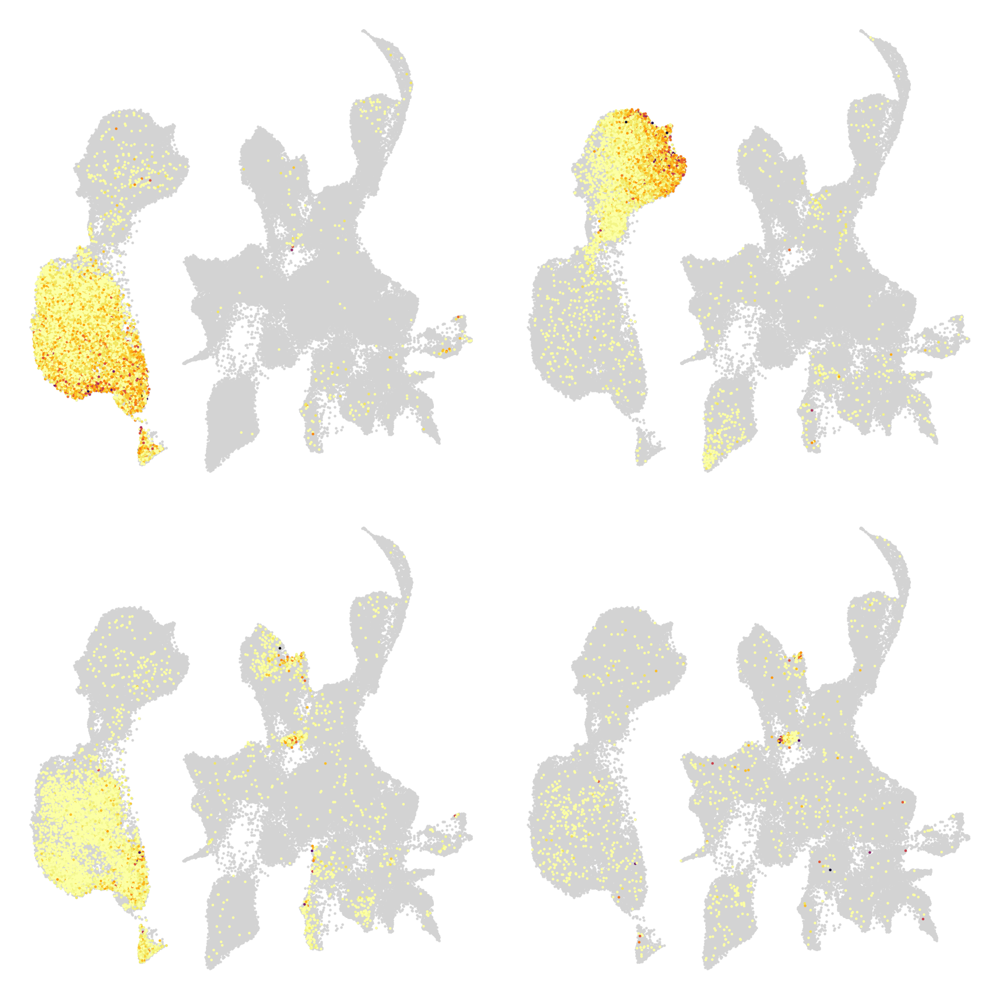

In [471]:
# Patterning of the forebrain
plt.figure(figsize=(12,12))
genes = ["EMX1", "DLX2", "NEUROG2","NHLH1"]
for i, gene in enumerate(genes):
    plt.subplot(2,2,i+1)
    cgplot.scattern(umap, c=ws.Expression[:, ws.Gene==gene].flatten(), bgval=0, s=5)
    #plt.title(gene)
    plt.axis("off")
    plt.tight_layout()

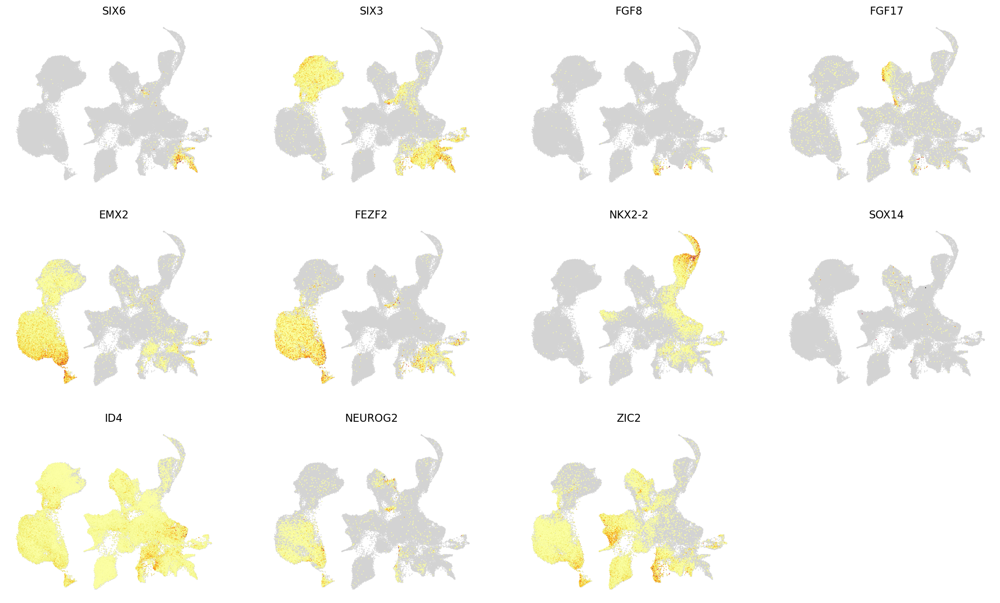

In [420]:
plt.figure(figsize=(24, 12))
genes = ["SIX6", "SIX3", "FGF8", "FGF17", "EMX2", "FEZF2", "NKX2-2", "SOX14", "ID4", "NEUROG2", "ZIC2"]
for i, gene in enumerate(genes):
    plt.subplot(2, 4, i+1)
    cgplot.scattern(umap, c=ws.Expression[:, ws.Gene==gene].flatten(), bgval=0, s=1)
    plt.title(gene)
    plt.axis("off")

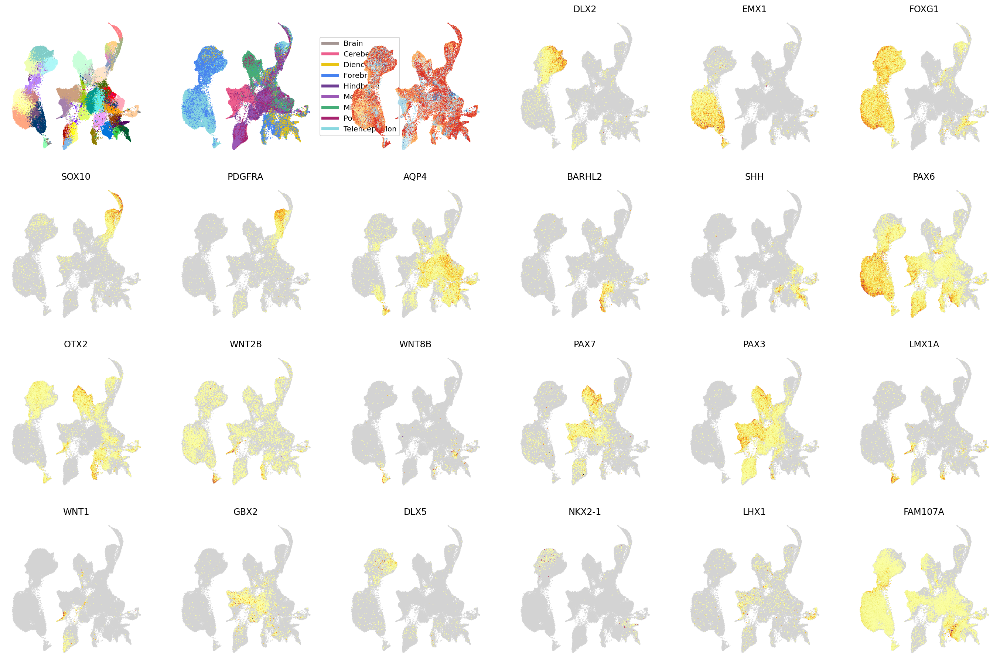

In [416]:
plt.figure(figsize=(24, 16))
genes = ["DLX2", "EMX1", "FOXG1", "SOX10", "PDGFRA", "AQP4", "BARHL2", "SHH", "PAX6", 
        "OTX2", "WNT2B", "WNT8B", "PAX7", "PAX3", "LMX1A", "WNT1", "GBX2", "DLX5", "NKX2-1", "LHX1", "FAM107A"]

plt.subplot(4, 6, 1)
cgplot.scatterc(umap, c=ws.Clusters[:], colors="colors75", s=1, legend=None)
plt.axis("off")

plt.subplot(4, 6, 2)
cgplot.scatterc(umap, c=ws.Region[:], colors="regions", s=1)
plt.axis("off")

plt.subplot(4, 6, 3)
cgplot.scattern(umap, c=ws.Age[:], cmap="age", vmin=5, vmax=14, s=1)
plt.axis("off")

for i, gene in enumerate(genes):
    plt.subplot(4, 6, i + 4)
    cgplot.scattern(umap, c=ws.Expression[:, ws.Gene==gene].flatten(), bgval=0, s=1)
    plt.title(gene)
    plt.axis("off")

(-8.956132245063781, 21.09494478702545, -6.346256995201111, 19.770587229728697)

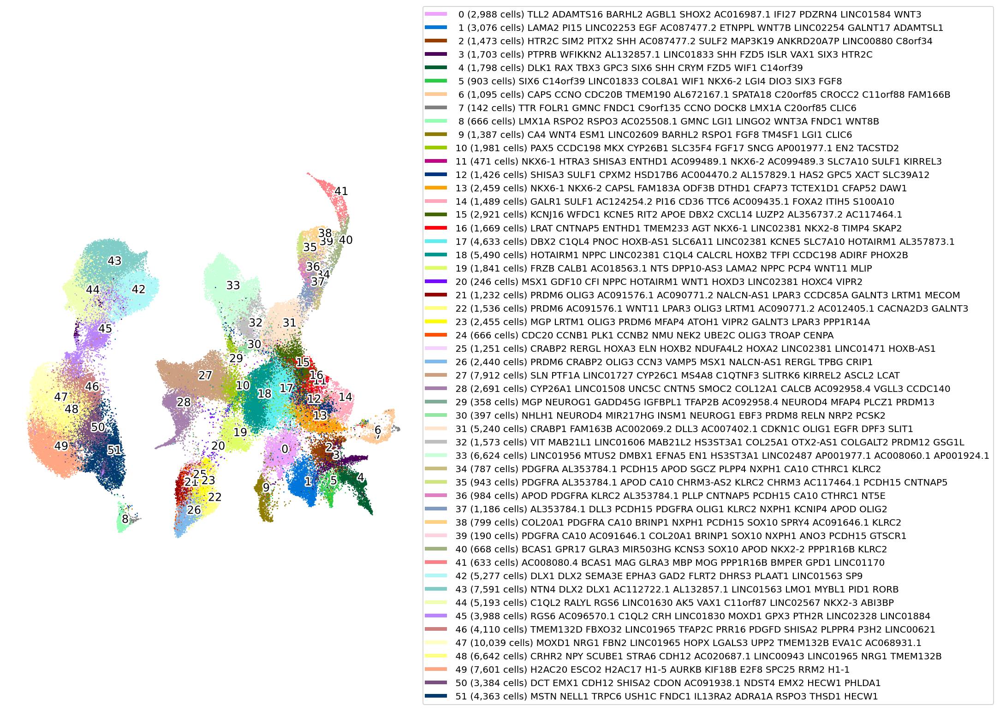

In [7]:
labels = []
n_cells = ws.NCells[:]
clusters = ws.Clusters[:]
n_clusters = clusters.max() + 1
cluster_ids = ws.ClusterID[:]
genes = ws.Gene[:]
enrichment = ws.Enrichment[:]
xy = umap

for i in range(ws.clusters.length):
    n = n_cells[cluster_ids == i][0]
    label = f"{i:>3} ({n:,} cells) "
    label += " ".join(genes[np.argsort(-enrichment[cluster_ids == i, :][0])[:10]])
    labels.append(label)

plt.figure(figsize=(8, 8))
ax = plt.subplot(111)


MAX_CLUSTERS = 100
top_clusters = np.argsort(np.bincount(clusters))[-MAX_CLUSTERS:]
for i in top_clusters:
    pos = np.median(xy[clusters == i], axis=0)
    txt = plt.text(pos[0], pos[1], str(i), size=12, color="black")
    txt.set_path_effects([PathEffects.withStroke(linewidth=3, foreground='w')])

if n_clusters > MAX_CLUSTERS:
    mask = np.isin(clusters, top_clusters)
    clusters[~mask] = n_clusters
    labels.append(f"{n_clusters} ({n_clusters - MAX_CLUSTERS} clusters not shown)")
cgplot.scatterc(xy, c=np.array(labels)[clusters], legend="outside")
plt.axis("off")



In [498]:
np.save("/proj/user/sten/cluster8.npy", ws.CellID[ws.Clusters == 8])

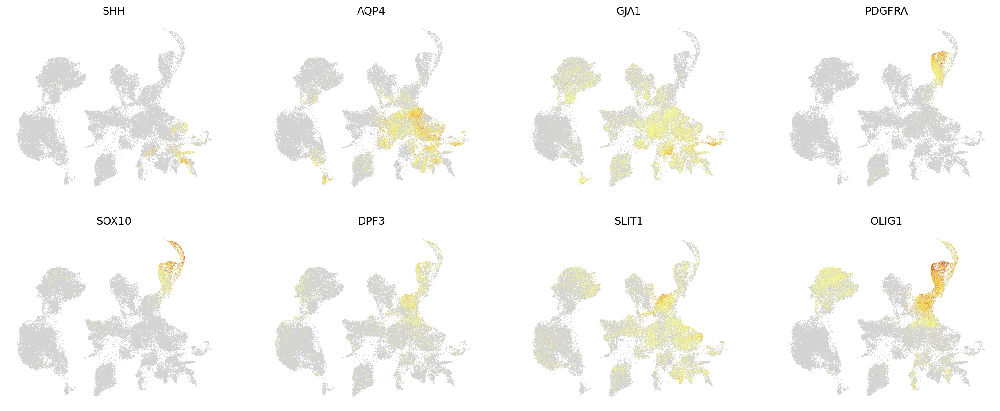

In [96]:
plt.figure(figsize=(20,8))
genes = ["SHH", "AQP4", "GJA1", "PDGFRA", "SOX10", "DPF3", "SLIT1", "OLIG1"]
for i, gene in enumerate(genes):
    plt.subplot(2, 4, i+1)
    cgplot.scattern(umap, c=ws.Expression[:, ws.Gene==gene].flatten(), bgval=0,s=0.2)
    plt.title(gene)
    plt.axis("off")

In [182]:
ws = db.builds.sten.humandev20220523.PreAstrocyte

In [101]:
umap = UMAP(n_neighbors=50, min_dist=0.5, init=ws.Embedding[:]).fit_transform(ws.Factors[:])

(-6.304807996749878,
 17.22887740135193,
 -3.1362640857696533,
 16.735004663467407)

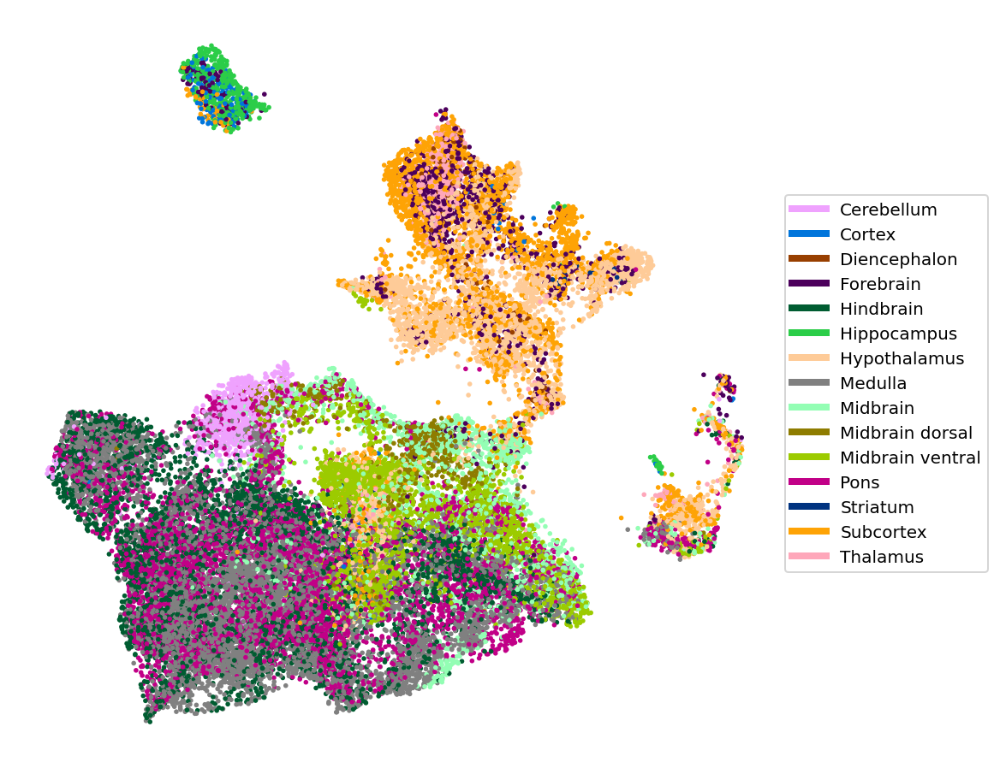

In [185]:
plt.figure(figsize=(8, 8))
cgplot.scatterc(umap, c=ws.Subregion[:], colors="colors75", legend="outside")
plt.axis("off")

(-6.304807996749878,
 17.22887740135193,
 -3.1362640857696533,
 16.735004663467407)

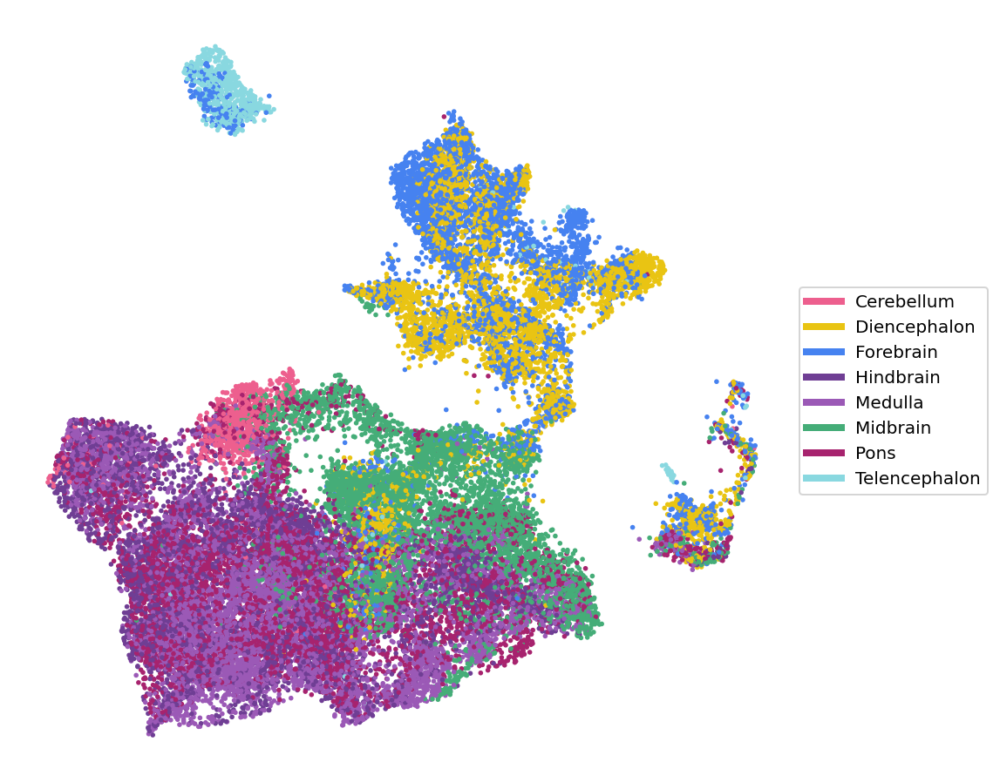

In [186]:
plt.figure(figsize=(8, 8))
cgplot.scatterc(umap, c=ws.Region[:], colors="regions", legend="outside")
plt.axis("off")

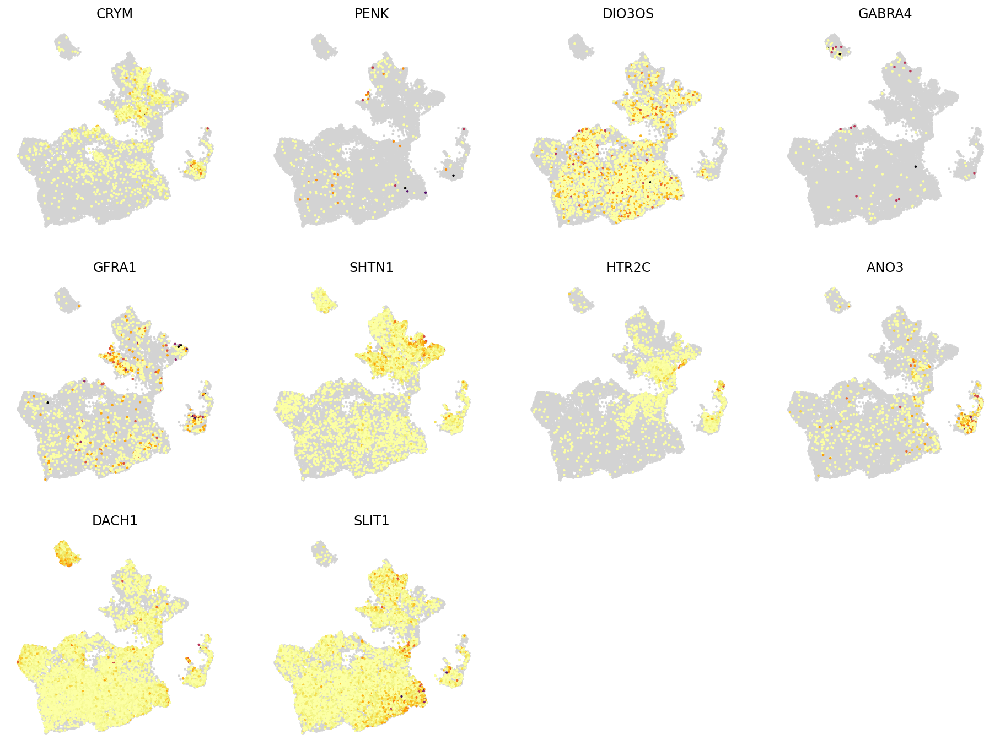

In [191]:
plt.figure(figsize=(16, 12))
genes = ["ZNF98", "HGF", "PIP5K1B", "PDE3B", "DPYSL5", "DGKZ", "RERG", "OLIG1", "FREM2", "LRRTM4"]
genes = ["CCBE1", "PLA2R1", "WDR86", "CACNA1A", "TBX5", "GALNT16", "LYN", "TMEM132C", "LPAR3", "RERG"]
genes = ["SLC8A1", "KCNQ3", "LAMA3", "EPHA6", "TMEM132C", "SLIT1", "NR2F2-AS1", "CA8", "GABRA4", "GNA14"]
genes = ["CRYM", "PENK", "DIO3OS", "GABRA4", "GFRA1", "SHTN1", "HTR2C", "ANO3", "DACH1", "SLIT1"]

for i, gene in enumerate(genes):
    plt.subplot(3, 4, i+1)
    cgplot.scattern(umap, c=ws.Expression[:, ws.Gene==gene].flatten(), bgval=0, s=5)
    plt.title(gene)
    plt.axis("off")

(-6.304807996749878,
 17.22887740135193,
 -3.1362640857696533,
 16.735004663467407)

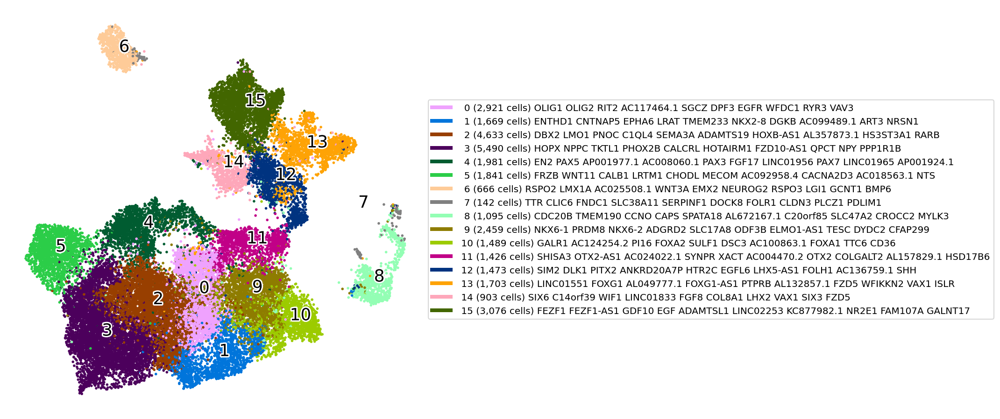

In [114]:
labels = []
n_cells = ws.NCells[:]
clusters = ws.Clusters[:]
n_clusters = clusters.max() + 1
cluster_ids = ws.ClusterID[:]
genes = ws.Gene[:]
enrichment = ws.Enrichment[:]
xy = umap

for i in range(ws.clusters.length):
    n = n_cells[cluster_ids == i][0]
    label = f"{i:>3} ({n:,} cells) "
    label += " ".join(genes[np.argsort(-enrichment[cluster_ids == i, :][0])[:10]])
    labels.append(label)

plt.figure(figsize=(8, 8))
ax = plt.subplot(111)


MAX_CLUSTERS = 100
top_clusters = np.argsort(np.bincount(clusters))[-MAX_CLUSTERS:]
for i in top_clusters:
    pos = np.median(xy[clusters == i], axis=0)
    txt = plt.text(pos[0], pos[1], str(i), size=18, color="black")
    txt.set_path_effects([PathEffects.withStroke(linewidth=3, foreground='w')])

if n_clusters > MAX_CLUSTERS:
    mask = np.isin(clusters, top_clusters)
    clusters[~mask] = n_clusters
    labels.append(f"{n_clusters} ({n_clusters - MAX_CLUSTERS} clusters not shown)")
cgplot.scatterc(xy, c=np.array(labels)[clusters], legend="outside")
plt.axis("off")

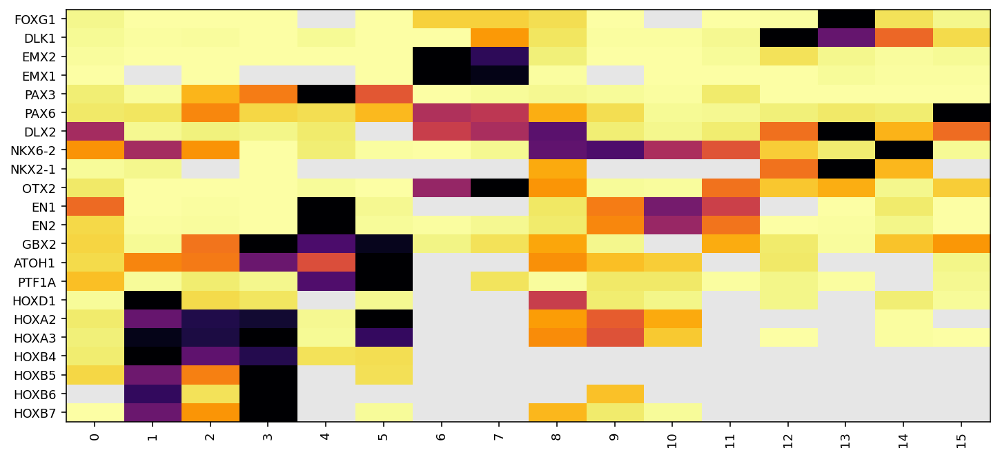

In [127]:
patterning_genes = ['FOXG1', 'DLK1', 'EMX2', 'EMX1', 'PAX3', 'PAX6',
                    'DLX2',  'NKX6-2', 'NKX2-1', 
                    'OTX2', 'EN1', 'EN2', 'GBX2', 'ATOH1', 'PTF1A',
                    'HOXD1', 'HOXA2', 'HOXA3', 'HOXB4', 'HOXB5', 'HOXB6', 'HOXB7']
#patterning_genes = [
#    'SOX2', 'NHLH1', 'NRXN3', 'STMN2', 'OLIG3', 'PAX6', 'SHH', 'NKX2-2', 'EMX2', 'WNT2B','FOXG1','EN2','WNT1','SIX6', 'FGF8','FGF17','BARHL1']


n_genes = len(patterning_genes)
n_clusters = ws.clusters.length
mean_x = ws.MeanExpression[:]
names = ws.Gene[:]
x = np.zeros((n_genes, n_clusters))
for i, gene in enumerate(patterning_genes):
    gene_ix = np.where(names == gene)[0][0]
    x[i, :] = mean_x[:, gene_ix]

# Normalize
totals = x.sum(axis=1)
x = (x.T / totals * np.median(totals)).T
x = cg.div0(x.T, np.percentile(x, 99.5, axis=1)).T


# Make background grey for zeros
bg = np.zeros_like(x) + 0.9
x = np.ma.masked_where(x == 0, x)

plt.figure(figsize=(12, n_genes / 4))
plt.imshow(bg, vmin=0, vmax=1, cmap=plt.cm.gray, aspect="auto")
plt.imshow(x, cmap="inferno_r", vmax=1, interpolation="none", aspect="auto", alpha=1)
plt.yticks(ticks=range(n_genes),labels=patterning_genes, fontsize=9)
plt.xticks(ticks=range(n_clusters), labels=ws.ClusterID[:], fontsize=9, rotation=90)
#plt.vlines(np.arange(0, n_clusters, 10) - 0.5, -0.5, n_genes - 0.5, color="black", linestyle="--")
None

In [128]:
n_telencephalon = np.bincount(ws.Age[np.isin(ws.Clusters[:], [6])].astype("int"))[5:]
n_diencephalon = np.bincount(ws.Age[np.isin(ws.Clusters[:], [12, 13, 14, 15])].astype("int"))[5:]
n_midbrain = np.bincount(ws.Age[np.isin(ws.Clusters[:], [0, 9, 10, 11])].astype("int"))[5:]
n_cerebellum = np.bincount(ws.Age[np.isin(ws.Clusters[:], [4])].astype("int"))[5:]
n_hindbrain = np.bincount(ws.Age[np.isin(ws.Clusters[:], [1, 2, 3, 5])].astype("int"))[5:]
wsall = db.builds.sten.humandev20220523.PoolClean
n_cells_total = np.bincount(wsall.Age[:].astype("int"))[5:]

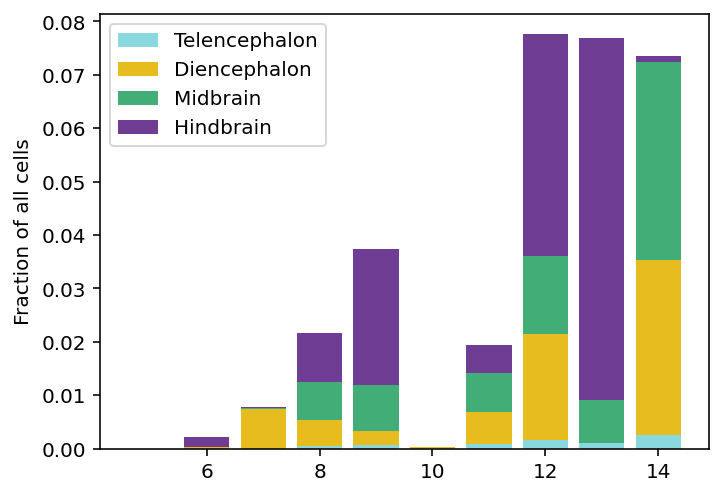

In [134]:
plt.figure(figsize=(12, 4))
plt.subplot(121)
bottoms = np.zeros(10)
plt.bar(np.arange(5, 15), n_telencephalon / n_cells_total, bottom=bottoms, label="Telencephalon", color="#89d8e0")
bottoms += n_telencephalon / n_cells_total
plt.bar(np.arange(5, 15), n_diencephalon / n_cells_total, bottom=bottoms, label="Diencephalon", color="#e7bc1f")
bottoms += n_diencephalon / n_cells_total
plt.bar(np.arange(5, 15), n_midbrain / n_cells_total, bottom=bottoms, label="Midbrain", color="#43ad78")
bottoms += n_midbrain / n_cells_total
plt.bar(np.arange(5, 15), n_hindbrain / n_cells_total, bottom=bottoms, label="Hindbrain", color="#6f3e94")
plt.legend()
plt.ylabel("Fraction of all cells")
#plt.subplot(122)
#plt.bar(np.arange(5, 15), n_preOPC, label="pre-OPC", color="burlywood")
#plt.bar(np.arange(5, 15), n_OPC, bottom=n_preOPC, label="OPC", color="orange")
#plt.bar(np.arange(5, 15), n_COP, bottom=(n_preOPC + n_OPC), label="COP", color="orangered")
#for x in range(5, 15):
#    n = (n_preOPC + n_OPC + n_COP)[x - 5]
#    plt.text(x, n, str(n), ha="center", va="bottom")
#plt.legend()
#plt.ylabel("Total number of cells")

None

<BarContainer object of 10 artists>

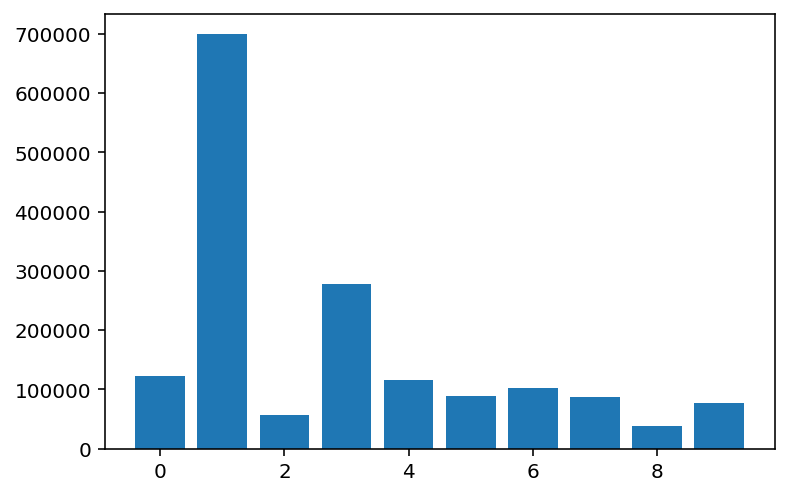

In [133]:
plt.bar(np.arange(10),height=n_cells_total)

(-6.304807996749878,
 17.22887740135193,
 -3.1362640857696533,
 16.735004663467407)

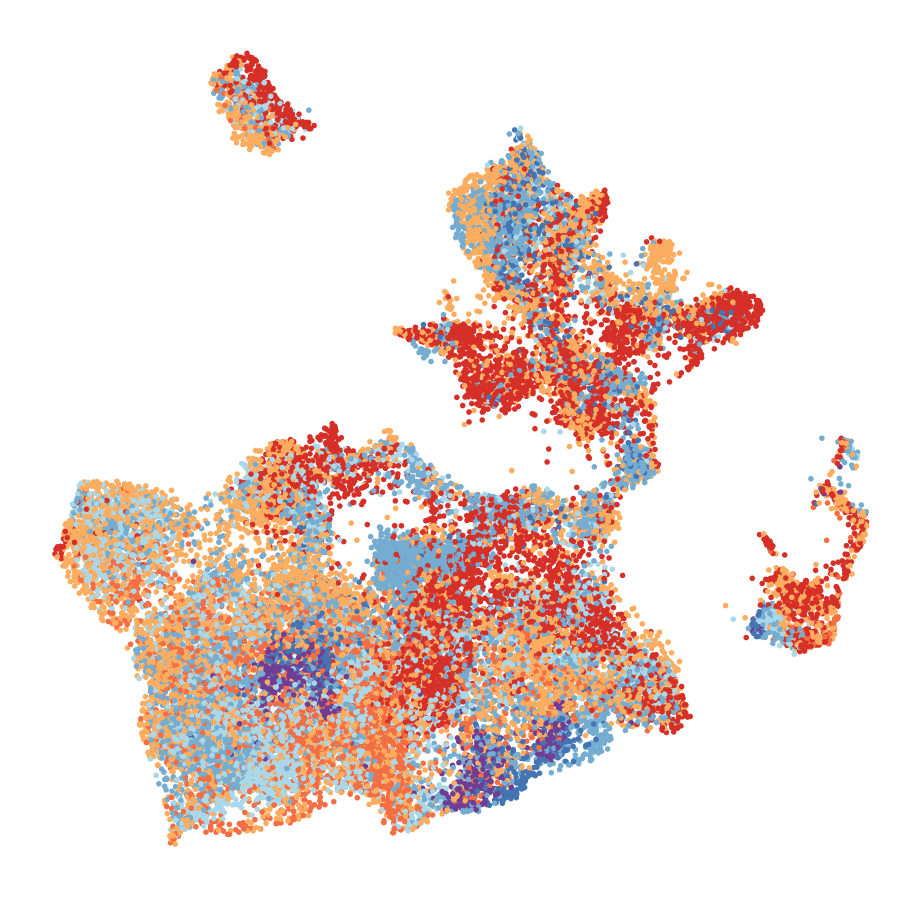

In [139]:
plt.figure(figsize=(8, 8))
cgplot.scattern(umap, c=ws.Age[:], cmap="age")
plt.axis("off")



In [141]:
(ws.Age[:] == 10).sum()

20

In [142]:
n_cells_total

array([122453, 699036,  56535, 277259, 115537,  88859, 102960,  86551,
        38967,  77780])

In [143]:
20/88000

0.00022727272727272727

In [144]:
ws = db.builds.sten.humandev20220523.BrainBasicPool
np.unique(ws.Subregion[:])

array(['Brain', 'Cerebellum', 'Cortex', 'Diencephalon', 'Forebrain',
       'Head', 'Hindbrain', 'Hippocampus', 'Hypothalamus', 'Medulla',
       'Midbrain', 'Midbrain dorsal', 'Midbrain ventral', 'Pons',
       'Striatum', 'Subcortex', 'Telencephalon', 'Thalamus'], dtype=object)

In [146]:
subregion_names = [
    'Head',
    'Brain', 
    'Forebrain',
    'Telencephalon', 
    'Cortex',
    'Hippocampus', 
    'Subcortex', 
    'Striatum',
    'Diencephalon', 
    'Hypothalamus', 
    'Thalamus',
    'Midbrain', 
    'Midbrain dorsal', 
    'Midbrain ventral', 
    'Hindbrain', 
    'Pons',
    'Cerebellum',  
    'Medulla'
]    

In [147]:
subregions = ws.Subregion[:]

In [148]:
ages = ws.Age[:].astype(int)

In [168]:
dists = []
for sn in subregion_names:
    dists.append(aggregate(ages, (sn == subregions).astype(int), func='sum', size=15)[5:])
dists = np.array(dists)

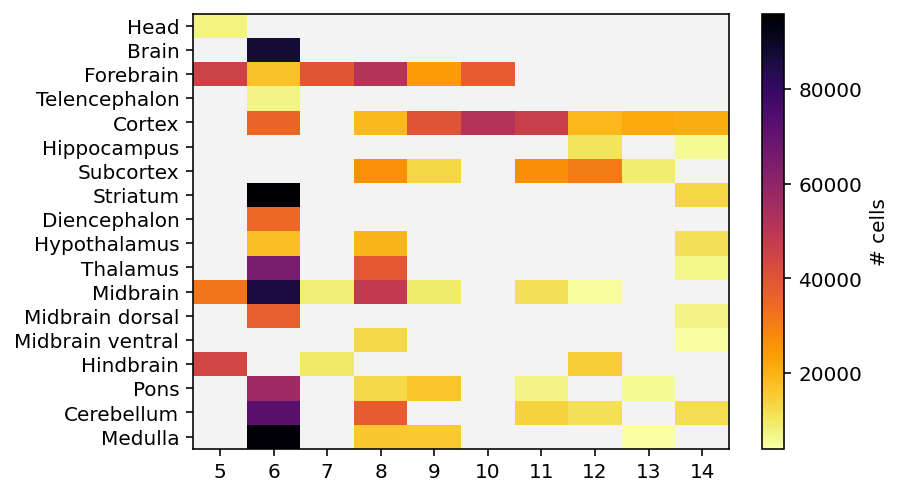

In [178]:
dists_masked = np.ma.masked_where(dists == 0, dists)
plt.imshow(np.zeros_like(dists) + 0.95, vmin=0, vmax=1, cmap=plt.cm.gray, aspect="auto")
plt.imshow(dists_masked, cmap="inferno_r", interpolation="none", aspect="auto", alpha=1)
plt.xticks(np.arange(10), labels=np.arange(5, 15))
plt.yticks(np.arange(18), labels=subregion_names)
plt.colorbar(label="# cells")
None

In [390]:
# wsref: the reference workspace (e.g. PoolClean)
# ws: the test workspace
# cells: the cells to extract from the test workspace (None to tak eall cells)
def age_distribution(wsref, ws, cells=None):
    region_defs = {
        "Brain": ["Brain"],
        "Forebrain": ["Forebrain", "Telencephalon", "Diencephalon", "Cortex", "Hippocampus", "Subcortex", "Striatum", "Diencephalon", "Hypothalamus", "Thalamus"],
        "Midbrain": ["Midbrain", "Midbrain dorsal", "Midbrain ventral"],
        "Hindbrain": ["Hindbrain", "Medulla", "Pons", "Cerebellum"],
        "Cortex": ["Cortex", "Hippocampus"],
        "Subcortex": ["Subcortex", "Striatum", "Diencephalon", "Hypothalamus", "Thalamus"],
        "Pons": ["Pons"],
        "Cerebellum": ["Cerebellum"],
        "Medulla": ["Medulla"]
    }

    valid_ages = {
        "Brain": np.array([5, 6, 7, 8, 9, 12]),
        "Forebrain": np.array([5, 6, 7, 8, 9, 10, 11, 12, 14]),
        "Midbrain": np.array([5, 6, 7, 8, 9, 11, 12, 14]),
        "Hindbrain": np.array([5, 6, 7, 8, 9, 12, 13]),

        "Cortex": np.array([6, 8, 9, 10, 11, 12, 13, 14]),
        "Subcortex": np.array([5, 6, 7, 8, 9, 10, 11, 12, 14]),
        "Pons": np.array([6, 8, 9, 11, 13]),
        "Cerebellum": np.array([6, 8, 11, 12, 14]),
        "Medulla": np.array([6, 9, 13])
    }

    # Tissue volume as function of age, pcw 5 to 14
    morphometry = {
        "Forebrain": np.array([0.26, 4.2, 23, 111, 290.088, 783.503, 1800.808, 2497.763, 4485.017, 6344]),
        "Midbrain": np.array([0.2, 1.75, 6.7, 22, 50.653, 64, 110.592, 135.796744, 166.375, 175.616]),
        "Hindbrain": np.array([0.69, 6.25, 22.9, 56, 94.176, 150.444, 204.507, 298.596457, 444.96, 432])
    }
    ref_regions = wsref.Subregion[:]
    ref_ages = wsref.Age[:].astype(int)
  
    # Sum up forebrain, midbrain, hindbrain
    ref_n_cells = np.zeros((9, 10), dtype="float32")
    test_n_cells = np.zeros((9, 10), dtype="float32")
    if cells is None:
        cells = np.ones(ws.cells.length, dtype=bool)
    test_regions = ws.Subregion[cells]
    test_ages = ws.Age[cells].astype(int)
    for i, (ref_region_name, specific_regions) in enumerate(region_defs.items()):
        ref_dist = aggregate(ref_ages, (np.isin(ref_regions, specific_regions)).astype(int), func='sum', size=15)[5:]
        test_dist = aggregate(test_ages, (np.isin(test_regions, specific_regions)).astype(int), func='sum', size=15)[5:]
        mask = np.ones_like(ref_dist, dtype=bool)
        mask[np.array(valid_ages[ref_region_name]) - 5] = False
        ref_dist[mask] = 0
        test_dist[mask] = 0
        ref_n_cells[i, :] = ref_dist
        test_n_cells[i, :] = test_dist
    
    # Now calculate how large a brain volume each sampled cell corresponds to
    volume = np.zeros_like(ref_n_cells)
    volume[1, :] = morphometry["Forebrain"]
    volume[2, :] = morphometry["Midbrain"]
    volume[3, :] = morphometry["Hindbrain"]
    volume[0, :] = volume[1:4, :].sum(axis=0)  # brain is the sum of fb,mb,hb
    volume[4, :] = volume[0, :]
    volume[5, :] = volume[0, :]
    volume[6, :] = volume[0, :]
    volume[7, :] = volume[0, :]
    volume[8, :] = volume[0, :]
    volume_per_cell = cg.div0(volume, ref_n_cells)
    
    test_volume = test_n_cells * volume_per_cell
    test_volume[0, :] = test_volume[1:4, :].sum(axis=0)
    test_volume_fraction = cg.div0(test_volume, volume)
    test_volume_fraction[0, (5, 6, 8, 9)] = 0  # Invalid Brain ages (5, 6, 13, 14) minus 5

    # Returns matrix with one row each for "Brain", "Forebrain", "Midbrain", "Hindbrain", and with one column per week 5 - 14
    # Also returns a dictionary that gives the valid ages for each region
    return test_volume_fraction, valid_ages
    

In [391]:
wsref = db.builds.sten.humandev20220523.BrainBasicPool
ws = db.builds.sten.humandev20220523.PreAstrocyte
distro, ages = age_distribution(wsref, ws)

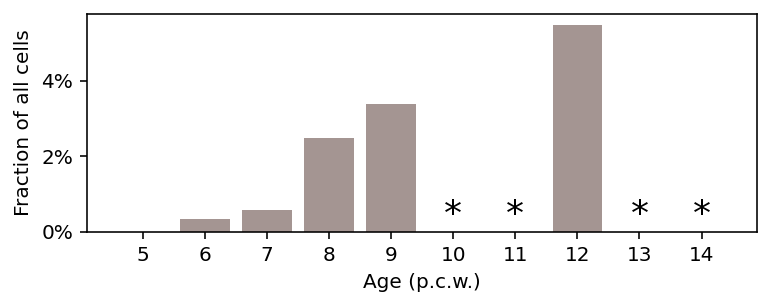

In [392]:
# Example of plotting the distribution for a single region (Brain)

import matplotlib as mpl
plt.figure(figsize=(6, 2))
ax=plt.subplot(111)
plt.bar(np.arange(5, 15), distro[0, :] * 100, color="#a49592")
plt.xticks(np.arange(5, 15), np.arange(5, 15))
ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(decimals=0))
for ix in np.arange(5, 15):
    if ix not in ages["Brain"]:
        plt.text(ix, 0, "*", va="bottom", ha="center", fontsize=18)
plt.xlabel("Age (p.c.w.)")
plt.ylabel("Fraction of all cells")
None

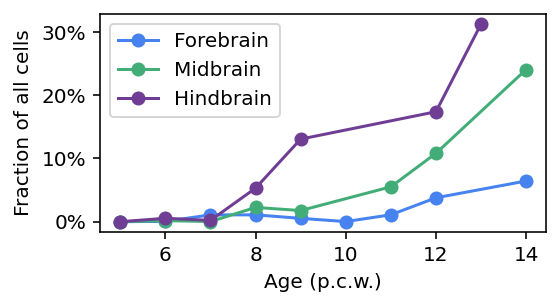

In [393]:
# Plotting forebrain, midbrain, hindbrain
plt.figure(figsize=(4, 2))
ax=plt.subplot(111)
xpos = np.arange(ref_dist.shape[0])
width = 0.2

valid_ages = ages["Forebrain"]
mask = np.zeros_like(ref_dist, dtype=bool)
mask[valid_ages - 5] = True
plt.plot(valid_ages, distro[1, mask] * 100, marker="o", color="#4682f0", label="Forebrain")
ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(decimals=0))

valid_ages = ages["Midbrain"]
mask = np.zeros_like(ref_dist, dtype=bool)
mask[valid_ages - 5] = True
plt.plot(valid_ages, distro[2, mask] * 100, marker="o", color="#43ad78", label="Midbrain")
ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(decimals=0))

valid_ages = ages["Hindbrain"]
mask = np.zeros_like(ref_dist, dtype=bool)
mask[valid_ages - 5] = True
plt.plot(valid_ages, distro[3, mask] * 100, marker="o", color="#6f3e94", label="Hindbrain")
ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(decimals=0))

plt.legend()
plt.xlabel("Age (p.c.w.)")
plt.ylabel("Fraction of all cells")
None

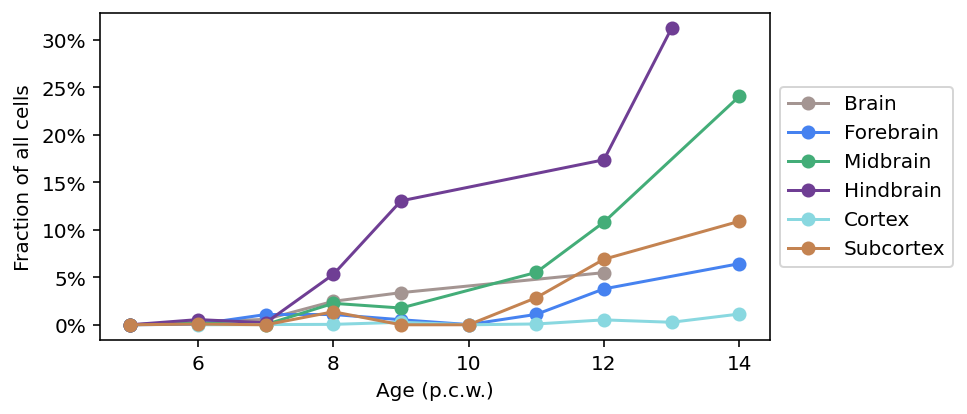

In [398]:
# Plotting all the regions
plt.figure(figsize=(6, 3))
ax=plt.subplot(111)
xpos = np.arange(ref_dist.shape[0])

colors = [
    "#a49592",
    "#4682f0",
    "#43ad78",
    "#6f3e94",
    "#89d8e0",
    "#c48351",
    "#a7236e",
    "#ed5f8e",
    "#955ba5"
]
for i, (region, valid_ages) in enumerate(ages.items()):
    if region not in ["Brain", "Forebrain", "Midbrain", "Hindbrain", "Cortex", "Subcortex"]:
        continue
    mask = np.zeros_like(ref_dist, dtype=bool)
    mask[valid_ages - 5] = True
    plt.plot(valid_ages, distro[i, mask] * 100, marker="o", color=colors[i], label=region)
    ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(decimals=0))

plt.legend( loc='center left', bbox_to_anchor=(1, 0.5))
plt.xlabel("Age (p.c.w.)")
plt.ylabel("Fraction of all cells")
None

In [270]:
# Distribution of oligo lineage cells
wsref = db.builds.sten.humandev20220523.BrainBasicPool
ws = db.builds.sten.humandev20220523.ClassGlioblastOligo
clusters = ws.Clusters[:]
ref_dist, preOPC_dist, preOPC_valid_ages = age_distribution("Brain", wsref, ws, np.isin(clusters, [31]))
ref_dist, OPC_dist, OPC_valid_ages = age_distribution("Brain", wsref, ws, np.isin(clusters, [34, 35, 36, 37, 38, 39]))
ref_dist, COP_dist, COP_valid_ages = age_distribution("Brain", wsref, ws, np.isin(clusters, [40, 41]))

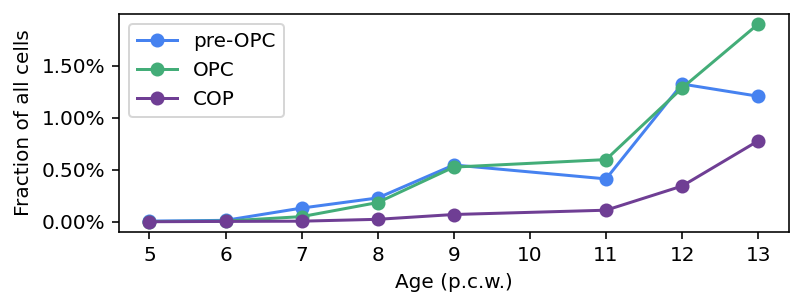

In [275]:
plt.figure(figsize=(6, 2))
ax=plt.subplot(111)
xpos = np.arange(ref_dist.shape[0])
width = 0.2

mask = np.zeros_like(ref_dist, dtype=bool)
mask[preOPC_valid_ages - 5] = True
plt.plot(preOPC_valid_ages, cg.div0(preOPC_dist, ref_dist)[mask] * 100, marker="o", color="#4682f0", label="pre-OPC")

mask = np.zeros_like(ref_dist, dtype=bool)
mask[OPC_valid_ages - 5] = True
plt.plot(OPC_valid_ages, cg.div0(OPC_dist, ref_dist)[mask] * 100, marker="o", color="#43ad78", label="OPC")

mask = np.zeros_like(ref_dist, dtype=bool)
mask[COP_valid_ages - 5] = True
plt.plot(COP_valid_ages, cg.div0(COP_dist, ref_dist)[mask] * 100, marker="o", color="#6f3e94", label="COP")

plt.legend()
plt.xticks(np.arange(5, 14), np.arange(5, 14))
ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter())
plt.xlabel("Age (p.c.w.)")
plt.ylabel("Fraction of all cells")
None

In [276]:
preOPC_dist

array([   7,   93,   75,  643,  645,    5,  435, 1204,  478, 1655])

In [277]:
OPC_dist

array([   2,   44,   28,  519,  621,  163,  631, 1169,  753,  959])

In [278]:
COP_dist

array([  0,  20,   3,  65,  82,  16, 117, 312, 308, 378])

In [ ]:
import scipy.sparse as sparse
ws = db.builds.sten.humandev20220523.PreAstrocyte
rc = ws.ManifoldIndices[:]
weights = ws.ManifoldWeights[:]
knn = sparse.coo_matrix(
